# Proyecto: Análisis de mercado inmobiliario

Ingeniería de Features, Modelos Avanzados e Interpretación de Modelos (4 sprints)


Propósito y Scope
Recientemente te has incorporado al equipo de Datos de una gran inmobiliaria. La primera tarea que te fue asignada fue ayudar a los tasadores/as a valuar las propiedades, ya que es un proceso difícil y, a veces, subjetivo. Para ello, se esperó que puedas crear un modelo de Machine Learning que, dadas ciertas características de la propiedad, prediga su precio de venta.

Ya has tenido una primera aproximación a este problema, pero ahora quieres estudiar si es posible mejorar su desempeño y obtener una visión más profunda del problema. Para ello, debes aplicar transformaciones de datos y entrenar algunos Modelos Avanzados. ¿Qué puedes aprender del problema que estás abordando mediante el estudio de tu propio modelo?


### 1. Transformación de datos

Elige cuáles de las siguientes transformaciones de datos son apropiadas para el dataset.
1. Detección y eliminación de outliers
2. Encoding
3. Imputación de valores faltantes 
4. Escalado de datos
5. Generación de nuevas variables predictoras/reducción de dimensionalidad

Implementa las transformaciones elegidas.

Vuelve a entrenar el modelo implementado en el Sprint Project 01 - en particular el Árbol de Decisión - con este nuevo dataset transformado.
Evalúa el desempeño:
¿Hay una mejora en su desempeño? Compara con el desempeño obtenido en el Sprint Project 01. Sea cuál sea la respuesta, explica a qué se debe. 

In [2]:
# Importo las librerías que se pueden utilizar en el trabajo
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import mean_squared_error

from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor

from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, accuracy_score, r2_score, make_scorer

from sklearn.ensemble import RandomForestRegressor, BaggingRegressor
from sklearn.svm import SVC, SVR
from xgboost.sklearn import XGBRegressor

from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD

import warnings
warnings.filterwarnings('ignore')


In [3]:
#Importo el dataset
properati = pd.read_csv('C:/Users/Admin/Desktop/Data Science/Sprint 1/Sprint Project 1/DS_Proyecto_01_Datos_Properati.csv')

In [4]:
# Veo filas y columnas
properati.shape

print("El dataset tiene",properati.shape[0], "filas.")
print("El dataset tiene",properati.shape[1], "columnas.")

El dataset tiene 146660 filas.
El dataset tiene 19 columnas.


In [5]:
# Imprimo cinco primeras filas
properati.head()

,start_date,end_date,created_on,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,title,description,property_type,operation_type
0,2019-10-17,2019-12-23,2019-10-17,-34.605880,-58.384949,Argentina,Capital Federal,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,USD,"***Venta semipiso centro, ideal hostel*****",DESCRIPCION DE LA PROPIEDAD: Departamento de 1...,Departamento,Venta
1,2019-10-17,2019-11-21,2019-10-17,-34.624056,-58.412110,Argentina,Capital Federal,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,USD,Espectacular PH reciclado en Boedo sin expensas.,PH reciclado en Boedo a una cuadra de la plaz...,PH,Venta
2,2019-10-17,2019-11-01,2019-10-17,-34.593569,-58.427474,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,USD,Depto.tipo casa de 2 ambientes en Venta en Pal...,"2 ambienets amplio , excelente estado , patio ...",PH,Venta
3,2019-10-17,2019-12-23,2019-10-17,-34.581294,-58.436754,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,USD,COSTA RICA 5800 / PALERMO HOLLYWOOD / VENTA PH...,HERMOSO PH EN PALERMO!!!2 AMBIENTES TOTALMENTE...,PH,Venta
4,2019-10-17,2020-03-11,2019-10-17,-34.914194,-57.938219,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,2.0,1.0,1.0,50.0,35.0,40000.0,USD,58 entre 1 y 2 Venta de departamento en ph.1 ...,58 entre 1 y 2 Venta de departamento en PH. P...,PH,Venta


In [6]:
# Veo tipo de datos
properati.dtypes

start_date          object
end_date            object
created_on          object
lat                float64
lon                float64
l1                  object
l2                  object
l3                  object
rooms              float64
bedrooms           float64
bathrooms          float64
surface_total      float64
surface_covered    float64
price              float64
currency            object
title               object
description         object
property_type       object
operation_type      object
dtype: object

En este caso se procede a eliminar las filas con idénticos valores ya que considero que no aportan al proyecto.

In [7]:
# Elimino instancias duplicadas

dataset_sin_dup = properati.drop_duplicates()
print(f'Numero de instancias duplicadas', properati.shape[0]-dataset_sin_dup.shape[0])
print(f'Numero de instancias del dataset filtrado', dataset_sin_dup.shape[0])

Numero de instancias duplicadas 2358
Numero de instancias del dataset filtrado 144302


In [8]:
# Se filtra el dataset para que sea comparable con el Sprint Project 1
propiedades = dataset_sin_dup[dataset_sin_dup.property_type.isin(["Departamento", "Casa", "PH"]) &
                               dataset_sin_dup.l2.isin(["Capital Federal"])]

#print('Cantidad orignal de filas',propiedades_sp2_df.shape[0],'con',propiedades_sp2_df.shape[1],'columnas')

propiedades = propiedades.drop(axis=0, index = propiedades.loc[propiedades.surface_total<15].index)
propiedades = propiedades.drop(axis=0, index = propiedades.loc[propiedades.surface_total>1000].index)
propiedades = propiedades.drop(axis=0, index = propiedades.loc[propiedades.price>4000000].index)

propiedades.shape

(89683, 19)

In [9]:
#Dejo sólo las columnas que considero útiles para el proyecto 

propiedades = propiedades[["l3", "rooms", "bedrooms", "bathrooms", "surface_total", "surface_covered", "price", "property_type"]]
propiedades

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
0,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Departamento
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH
5,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH
...,...,...,...,...,...,...,...,...
146554,Palermo,4.0,3.0,3.0,175.0,111.0,570000.0,PH
146555,Palermo,3.0,2.0,2.0,144.0,134.0,480000.0,PH
146556,Palermo,4.0,2.0,2.0,317.0,143.0,530000.0,PH
146557,Palermo,3.0,2.0,2.0,145.0,145.0,420000.0,Departamento


In [10]:
# Veo algunos datos estadísticos del dataset
propiedades.describe()

,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,89683.000000,89683.000000,87540.000000,80967.000000,80660.000000,8.968300e+04
mean,2.964196,1.959892,1.557722,95.194548,84.807513,2.566636e+05
std,1.315431,1.073495,0.856082,77.077075,156.443493,2.858601e+05
min,1.000000,0.000000,1.000000,15.000000,1.000000,6.000000e+03
25%,2.000000,1.000000,1.000000,49.000000,44.000000,1.200000e+05
50%,3.000000,2.000000,1.000000,71.000000,63.000000,1.750000e+05
75%,4.000000,3.000000,2.000000,110.000000,96.000000,2.782000e+05
max,26.000000,15.000000,14.000000,1000.000000,17220.000000,4.000000e+06


Con la función describe se puede observar que hay algunos valores atípicos que tienen una desviación estándar alta, por lo que los valores están dispersos. También se observa en la diferencia entre mínimos y máximos para algunas variables. Esto puede ser un indicio de que hay outliers.

Otra pregunta que nos podemos realizar es si puede haber bedrooms con valor cero, entiendo que sí, siempre que hablemos de que hay monoambientes.


In [11]:
propiedades.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
0,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Departamento
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH
5,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH


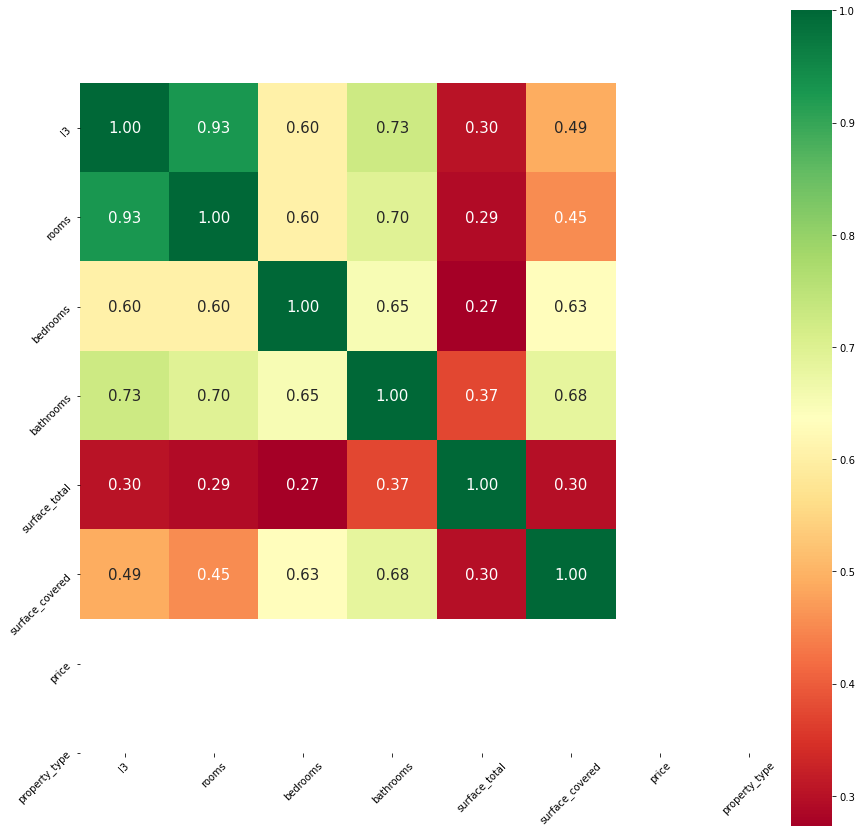

In [12]:
#Veo las correlaciones entre los atributos
corr = propiedades.corr()
plt.figure(figsize=(15,15))
sns.heatmap(corr, cbar = True,  square = True, annot=True, fmt= '.2f',annot_kws={'size': 15},
           xticklabels= propiedades.columns, 
           yticklabels= propiedades.columns,
           cmap= 'RdYlGn')
plt.xticks(rotation = 45)
plt.yticks(rotation = 45)
plt.show()

In [13]:
#Imprimo nombre de las columnas
propiedades.columns

columnas= pd.DataFrame(propiedades)
for column in columnas:
    print(column)

l3
rooms
bedrooms
bathrooms
surface_total
surface_covered
price
property_type


In [14]:
# Hay casos donde la superficie cubierta es mayor que la superficie total, se presupone que corresponden a instancias que se completaron de manera incorrecta, 
#imputando los datos de forma cruzada

superficies_incorrectas = propiedades.loc[propiedades.surface_total < propiedades.surface_covered]
print(len(superficies_incorrectas))

751


In [15]:
propiedades.loc[superficies_incorrectas.index,'surface_total'] = superficies_incorrectas.surface_covered
propiedades.loc[superficies_incorrectas.index,'surface_covered'] = superficies_incorrectas.surface_total
### Para verificar que las invirtio bien
superficies_incorrectas = propiedades.loc[propiedades.surface_total < propiedades.surface_covered]
print(len(superficies_incorrectas))
propiedades.reset_index(drop=True,inplace=True)

0



**Eliminación de outliers**

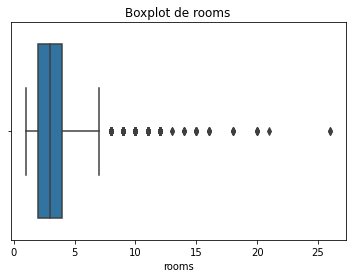

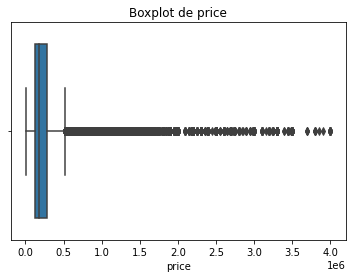

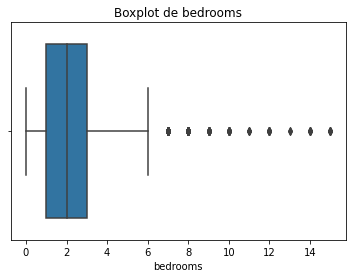

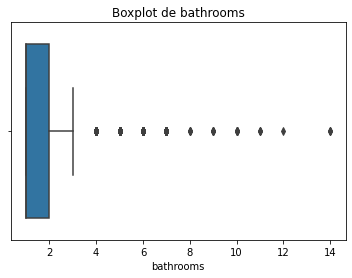

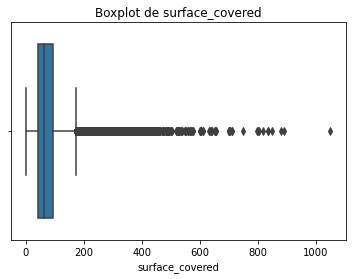

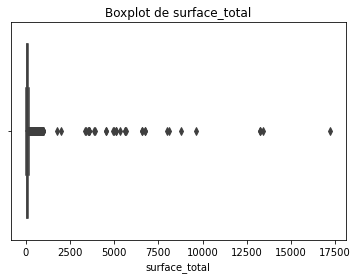

In [16]:
# Se analiza mediante bloxplots los outliers de los atributos numéricos

for atributo in ["rooms", "price", "bedrooms", "bathrooms", "surface_covered", "surface_total"]:
    sns.boxplot(propiedades[atributo])
    plt.title(f"Boxplot de {atributo}")
    plt.show()

In [17]:
#Eliminación de outliers del dataset completo

q1 = propiedades.quantile(0.25)
q3 = propiedades.quantile(0.75)
iqr = q3 - q1
propiedades_sin_outliers=propiedades[~((propiedades < (q1 - 1.5 * iqr)) |(propiedades > (q3 + 1.5 * iqr))).any(axis=1)]

In [18]:
# Vemos el tamaño del dataset luego de eliminar outliers y realizamos un nuevo describe para ver cómo se modificaron los estadísticos del dataset modificado
propiedades_sin_outliers.shape


(78528, 8)

In [19]:
propiedades_sin_outliers.describe()

,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,78528.000000,78528.000000,76526.000000,70435.000000,70155.000000,78528.000000
mean,2.706309,1.760353,1.358636,73.414368,64.541031,184961.765867
std,1.033100,0.883724,0.577145,35.272915,29.217156,93183.896129
min,1.000000,0.000000,1.000000,15.000000,1.000000,7500.000000
25%,2.000000,1.000000,1.000000,47.000000,42.000000,115000.000000
50%,3.000000,2.000000,1.000000,65.000000,57.000000,160000.000000
75%,3.000000,2.000000,2.000000,90.000000,80.000000,235000.000000
max,7.000000,6.000000,3.000000,204.000000,174.000000,515407.000000


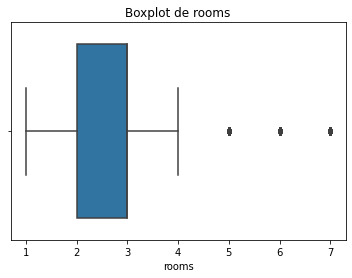

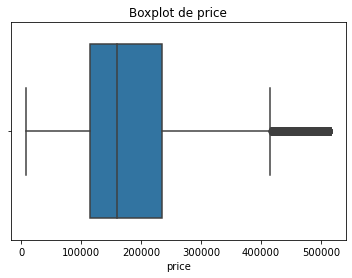

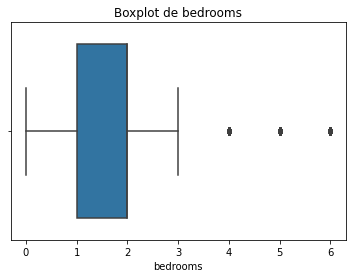

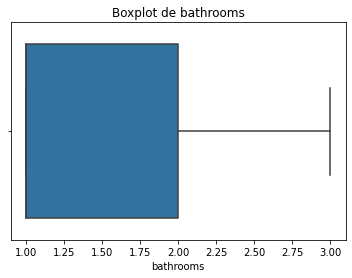

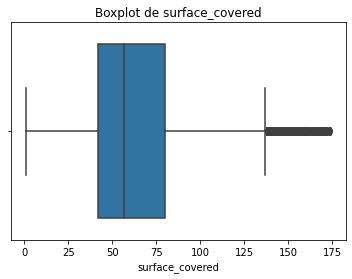

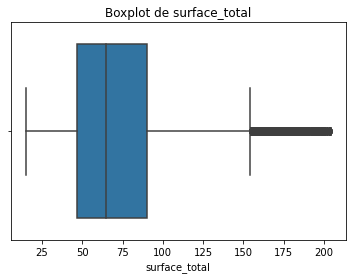

In [20]:
# Volvemos a realizar bloxplots luego de eliminados los outliers 

for atributo in ["rooms", "price", "bedrooms", "bathrooms", "surface_covered", "surface_total"]:
    sns.boxplot(propiedades_sin_outliers[atributo])
    plt.title(f"Boxplot de {atributo}")
    plt.show()

**Imputación de valores faltantes**

In [21]:
# Valores faltantes
datos_faltantes= pd.DataFrame(propiedades_sin_outliers.isna().sum(), columns = ["valores_faltantes"])
datos_faltantes[datos_faltantes.valores_faltantes>0]

,valores_faltantes
bathrooms,2002
surface_total,8093
surface_covered,8373


Hay valores faltantes en baños, superficie cubierta y total.

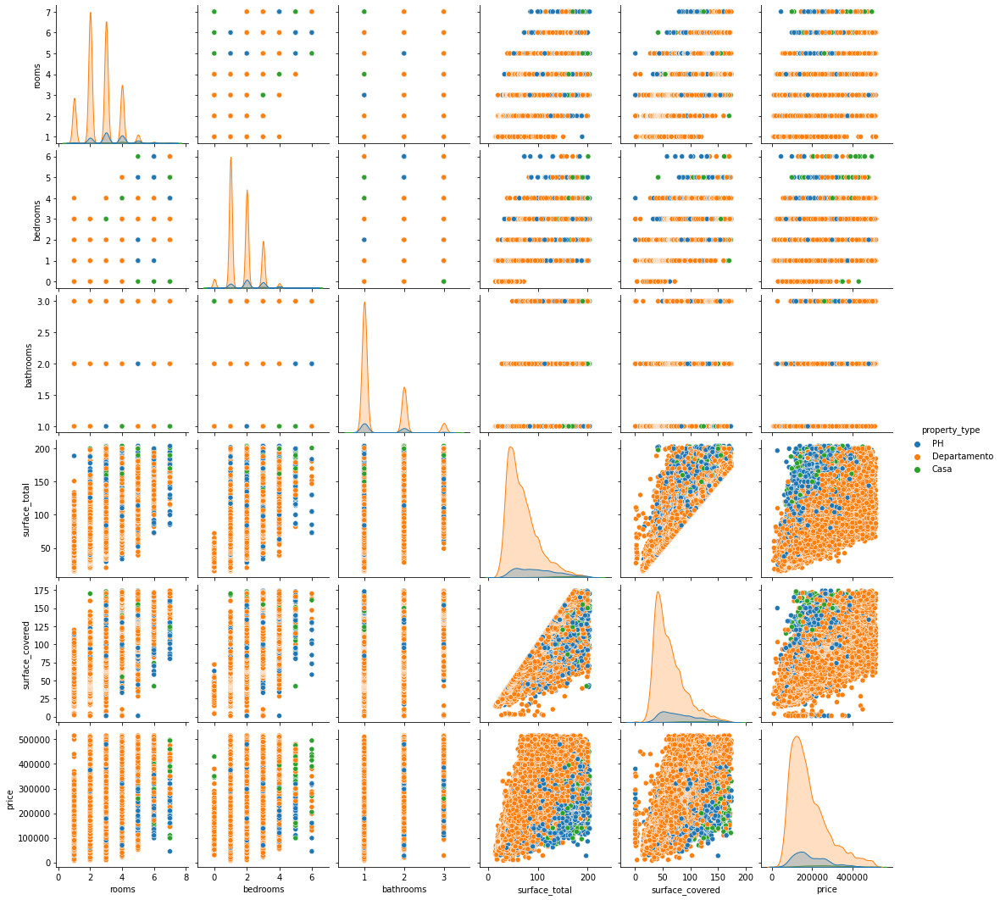

In [22]:
# Graficamos un pairplot para ver la distribución de las variables

sns.pairplot(propiedades_sin_outliers, hue = 'property_type')
plt.show()

Para los tres atributos con valores faltantes vamos a reemplazarlos con alguna medida estadística, haciendo la imputación por tipo de propiedad.

In [23]:
# Se imputan los valores en función al tipo de propiedad y aplicando la mediana a los valores faltantes
propiedades_sin_outliers.bathrooms = propiedades_sin_outliers.bathrooms.fillna(propiedades_sin_outliers.property_type.map(propiedades_sin_outliers.groupby("property_type")["bathrooms"].median()))
propiedades_sin_outliers.surface_total = propiedades_sin_outliers.surface_total.fillna(propiedades_sin_outliers.property_type.map(propiedades_sin_outliers.groupby("property_type")["surface_total"].median()))
propiedades_sin_outliers.surface_covered = propiedades_sin_outliers.surface_covered.fillna(propiedades_sin_outliers.property_type.map(propiedades_sin_outliers.groupby("property_type")["surface_covered"].median()))

In [24]:
# Veo que no queden nulos en el dataset
propiedades_sin_outliers.isna().sum()

l3                 0
rooms              0
bedrooms           0
bathrooms          0
surface_total      0
surface_covered    0
price              0
property_type      0
dtype: int64

In [25]:

propiedades_sin_outliers.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH


In [26]:
propiedades_sin_nulos = propiedades_sin_outliers
propiedades_sin_nulos.shape

(78528, 8)

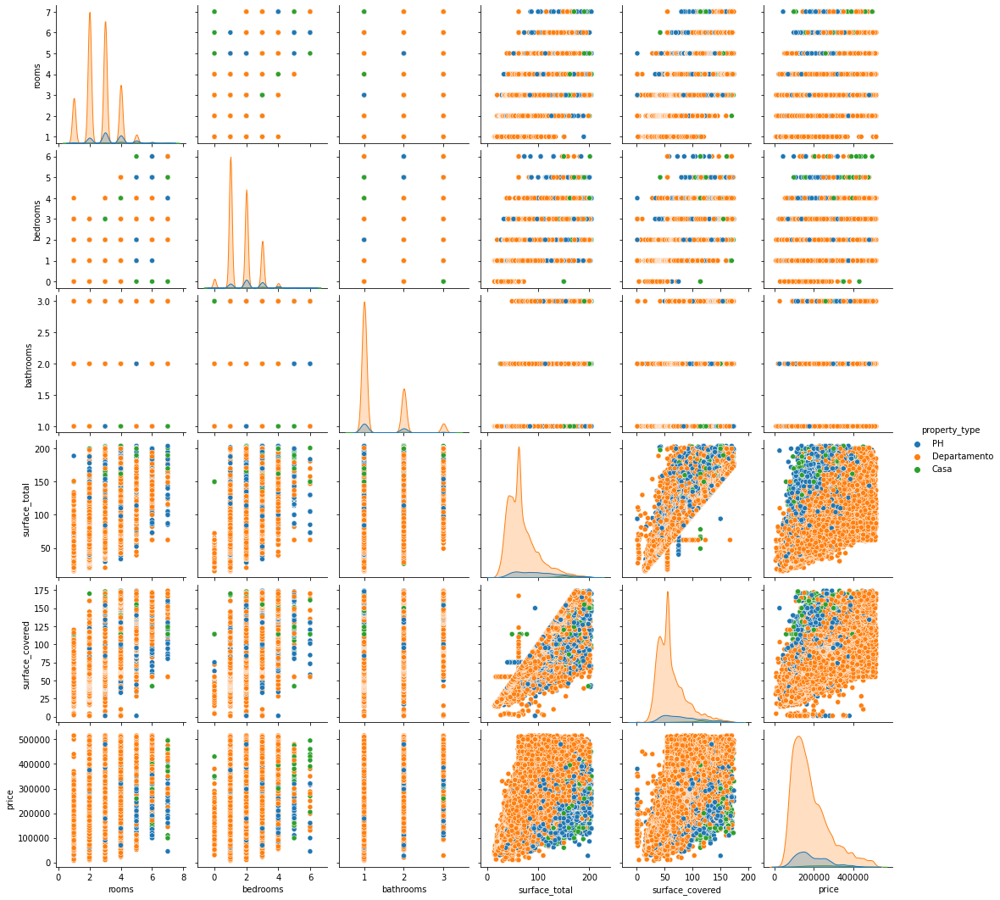

In [42]:
# Graficamos nuevamente un pairplot para ver si hubo modificaciones en la distribución de las variables

sns.pairplot(propiedades_sin_nulos, hue = 'property_type')
plt.show()

In [27]:
prop_clusters = propiedades_sin_nulos.copy()

**Encoding**

Para realizar el encoding voy a utilizar el método de Get Dummies. Se aplica sobre las variables l3 y property_types

In [28]:
propiedades_sin_nulos.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH


In [29]:
from sklearn.preprocessing import LabelBinarizer
# Create LabelBinzarizer object
LabelBi = LabelBinarizer()

In [30]:
# Se entrena y transforman los datos para l3
LabelBi.fit_transform(propiedades_sin_nulos["l3"])

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [31]:
# Inspecciono los valors de l3
LabelBi.classes_

array(['Abasto', 'Agronomía', 'Almagro', 'Balvanera', 'Barracas',
       'Barrio Norte', 'Belgrano', 'Boca', 'Boedo', 'Caballito',
       'Catalinas', 'Centro / Microcentro', 'Chacarita', 'Coghlan',
       'Colegiales', 'Congreso', 'Constitución', 'Flores', 'Floresta',
       'Las Cañitas', 'Liniers', 'Mataderos', 'Monserrat', 'Monte Castro',
       'Nuñez', 'Once', 'Palermo', 'Parque Avellaneda',
       'Parque Centenario', 'Parque Chacabuco', 'Parque Chas',
       'Parque Patricios', 'Paternal', 'Pompeya', 'Puerto Madero',
       'Recoleta', 'Retiro', 'Saavedra', 'San Cristobal', 'San Nicolás',
       'San Telmo', 'Tribunales', 'Velez Sarsfield', 'Versalles',
       'Villa Crespo', 'Villa Devoto', 'Villa General Mitre',
       'Villa Lugano', 'Villa Luro', 'Villa Ortuzar', 'Villa Pueyrredón',
       'Villa Real', 'Villa Riachuelo', 'Villa Santa Rita',
       'Villa Soldati', 'Villa Urquiza', 'Villa del Parque'], dtype='<U20')

In [32]:
propiedades_sin_nulos

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH
...,...,...,...,...,...,...,...,...
89672,Palermo,3.0,2.0,2.0,82.0,82.0,475000.0,Departamento
89673,Palermo,3.0,2.0,1.0,84.0,84.0,178000.0,PH
89674,Palermo,5.0,2.0,2.0,114.0,95.0,298000.0,PH
89679,Palermo,3.0,2.0,2.0,144.0,134.0,480000.0,PH


In [33]:
# Aplico get dummies para el atributo l3
l3_dummies = pd.get_dummies(propiedades_sin_nulos.l3)

In [34]:
# Se incorporan las columnas encodeadas al dataset
propiedades_encoded_1 = pd.concat([propiedades_sin_nulos, l3_dummies], axis=1)
propiedades_encoded_1 

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,Abasto,Agronomía,...,Villa Lugano,Villa Luro,Villa Ortuzar,Villa Pueyrredón,Villa Real,Villa Riachuelo,Villa Santa Rita,Villa Soldati,Villa Urquiza,Villa del Parque
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89672,Palermo,3.0,2.0,2.0,82.0,82.0,475000.0,Departamento,0,0,...,0,0,0,0,0,0,0,0,0,0
89673,Palermo,3.0,2.0,1.0,84.0,84.0,178000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
89674,Palermo,5.0,2.0,2.0,114.0,95.0,298000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0
89679,Palermo,3.0,2.0,2.0,144.0,134.0,480000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,0


In [35]:
# Repito los pasos para el atributo de tipo de propiedad
LabelBi.fit_transform(propiedades_encoded_1["property_type"])

array([[0, 0, 1],
       [0, 0, 1],
       [0, 0, 1],
       ...,
       [0, 0, 1],
       [0, 0, 1],
       [0, 1, 0]])

In [36]:
prop_types_dummies = pd.get_dummies(propiedades_encoded_1.property_type)

In [37]:
propiedades_encoded = pd.concat([propiedades_encoded_1, prop_types_dummies], axis=1)
propiedades_encoded

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,Abasto,Agronomía,...,Villa Pueyrredón,Villa Real,Villa Riachuelo,Villa Santa Rita,Villa Soldati,Villa Urquiza,Villa del Parque,Casa,Departamento,PH
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89672,Palermo,3.0,2.0,2.0,82.0,82.0,475000.0,Departamento,0,0,...,0,0,0,0,0,0,0,0,1,0
89673,Palermo,3.0,2.0,1.0,84.0,84.0,178000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
89674,Palermo,5.0,2.0,2.0,114.0,95.0,298000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1
89679,Palermo,3.0,2.0,2.0,144.0,134.0,480000.0,PH,0,0,...,0,0,0,0,0,0,0,0,0,1


Una vez que se encodearon ambas variables, pasamos a eliminar del dataset las variables categóricas

In [38]:
propiedades_num = propiedades_encoded.drop(["l3", "property_type"], axis=1)
propiedades_num.head()

,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,Abasto,Agronomía,Almagro,Balvanera,...,Villa Pueyrredón,Villa Real,Villa Riachuelo,Villa Santa Rita,Villa Soldati,Villa Urquiza,Villa del Parque,Casa,Departamento,PH
1,2.0,1.0,2.0,70.0,58.0,159000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,2.0,1.0,1.0,45.0,45.0,125000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,2.0,1.0,1.0,85.0,50.0,295000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4,2.0,1.0,1.0,56.0,56.0,150000.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
5,2.0,1.0,1.0,70.0,70.0,159500.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


**Escalado de datos**


In [39]:
# Defino el target y los atributos a considerar para el modelo 
X = propiedades_num.drop(["price"], axis=1)
y = propiedades_num["price"]

In [40]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [41]:
# Aplico un árbol de decisión tal como el caso del sprint project 1 con los mismos hiperparámetros sin escalar
tree_regressor = DecisionTreeRegressor(max_depth=17, random_state=42)

In [42]:
tree_regressor.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=17, random_state=42)

In [43]:
y_train_pred = tree_regressor.predict(X_train)
y_test_pred = tree_regressor.predict(X_test)

In [44]:

rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))
print(f'Raíz del error cuadrático medio en Train: {rmse_train}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test}')

Raíz del error cuadrático medio en Train: 32826.51357270692
Raíz del error cuadrático medio en Test: 42256.411691048546


In [45]:
tree_regressor.get_depth()

17

In [46]:
# Se escalan los datos
scl = StandardScaler()
X_train_esc = scl.fit_transform(X_train)
X_test_esc = scl.transform(X_test)
X_train_esc = pd.DataFrame(X_train_esc)
X_train_esc.head()

,0,1,2,3,4,5,6,7,8,9,...,55,56,57,58,59,60,61,62,63,64
0,-0.682786,-0.860804,-0.61011,-0.517005,-0.527926,-0.076762,-0.044574,-0.312588,-0.189267,-0.091258,...,-0.092165,-0.038415,-0.0209,-0.063679,-0.0209,-0.201364,7.772894,-0.119741,0.362361,-0.336896
1,0.283788,0.272089,-0.61011,-0.251365,-0.133864,-0.076762,-0.044574,-0.312588,-0.189267,-0.091258,...,-0.092165,-0.038415,-0.0209,-0.063679,-0.0209,-0.201364,-0.128652,-0.119741,0.362361,-0.336896
2,1.250362,1.404981,-0.61011,1.017806,1.012496,-0.076762,-0.044574,-0.312588,-0.189267,-0.091258,...,-0.092165,-0.038415,-0.0209,-0.063679,-0.0209,-0.201364,-0.128652,-0.119741,0.362361,-0.336896
3,-0.682786,-0.860804,-0.61011,-0.635068,-0.599573,-0.076762,-0.044574,-0.312588,-0.189267,-0.091258,...,-0.092165,-0.038415,-0.0209,-0.063679,-0.0209,-0.201364,-0.128652,-0.119741,0.362361,-0.336896
4,-1.649361,-1.993696,-0.61011,-0.310396,-0.312983,-0.076762,-0.044574,-0.312588,-0.189267,-0.091258,...,-0.092165,-0.038415,-0.0209,-0.063679,-0.0209,-0.201364,-0.128652,-0.119741,0.362361,-0.336896


In [47]:
# Se vuelve a aplicar un árbol de decisión pero esta vez sobre los datos escalados
tree_regressor_esc = DecisionTreeRegressor(max_depth=17, random_state=42)
tree_regressor_esc.fit(X_train_esc, y_train)

DecisionTreeRegressor(max_depth=17, random_state=42)

In [48]:
y_train_pred_esc = tree_regressor_esc.predict(X_train_esc)
y_test_pred_esc = tree_regressor_esc.predict(X_test_esc)

In [49]:
rmse_train_esc = np.sqrt(mean_squared_error(y_train, y_train_pred_esc))
rmse_test_esc = np.sqrt(mean_squared_error(y_test, y_test_pred_esc))
print(f'Raíz del error cuadrático medio en Train: {rmse_train_esc}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_esc}')

Raíz del error cuadrático medio en Train: 32826.51357270692
Raíz del error cuadrático medio en Test: 42283.41386374712


Vemos que para el modelo de Árbol de Decisión el escalado de datos no genera una diferencia en error de train y testeo

En el proyecto 1 el mejor modelo era utilizando el Árbol de Decisión con una profundidad de 17. Utilizamos el mismo parámetro para realizar la comparación entre un resultado y otro.

Recordemos que el RMSE mínimo para el primer proyecto fue:

Train: 64721.069773

Test: 146092.758486

Con la aplicación del mismo modelo con las transformaciones de los datos vemos que mejora el desempeño, disminuyendo el RMSE a 42283.41.

### 2. Modelos avanzados

Elige dos de los modelos avanzados vistos durante el segundo Sprint (¡no te olvides de la regresión lineal con atributos polinómicos y regularización!). Entrénalos y evalúalos con sus argumentos por defecto.

Optimiza sus hiperparámetros mediante Validación Cruzada y Grid Search o Random Search

Compara el desempeño de los nuevos modelos entre sí y con el modelo de la Parte A. ¿Cuál elegirías? Justifica

In [155]:
# Definimos una función para ver la diferencia por modelo que nos devuelve el RMSE y grafica
def evaluar_regresion(model, X_train, X_test, y_train, y_test):
    
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    ### CALCULAMOS EL ERROR
    rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
    rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))
     
    print(f'Model: {model}')
    
    print(f'Raíz del error cuadrático medio en Train: {rmse_train}')
    print(f'Raíz del error cuadrático medio en Test: {rmse_test}')
    
    plt.figure(figsize = (14,7))

    plt.subplot(1,2,1)
    sns.distplot(y_train - y_train_pred, bins = 20, label = 'train')
    sns.distplot(y_test - y_test_pred, bins = 20, label = 'test')
    plt.xlabel('errores')
    plt.legend()


    ax = plt.subplot(1,2,2)
    ax.scatter(y_test,y_test_pred, s =2)

    lims = [
    np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
    np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes]
    ]

    ax.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
    plt.xlabel('y (test)')
    plt.ylabel('y_pred (test)')

    plt.tight_layout()
    plt.show()

#### Modelo 1: Polynomial Features

In [73]:
# Importamos las librerías necesarias
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso

In [74]:
poly = PolynomialFeatures(degree = 2, include_bias=False) #Se define un degree igual a 2 que es el máximo que permite la computadora
X_train_new = poly.fit_transform(X_train_esc)
X_test_new = poly.transform(X_test_esc) # VER
print(X_train_new.shape, X_test_new.shape)


(54969, 2210) (23559, 2210)


In [75]:
reg_2 = LinearRegression()
reg_2.fit(X_train_new, y_train)
print(reg_2.coef_, reg_2.intercept_)
y_train_pred_2 = reg_2.predict(X_train_new)
y_test_pred_2 = reg_2.predict(X_test_new)

[-5.51953946e+05  3.90065508e+05  3.22307418e+05 ...  1.39131286e+10
  9.36064844e+09 -2.82024590e+09] -25461436051.655704


In [76]:
# Vemos el RMSE sin graficar
rmse_train_lr = np.sqrt(mean_squared_error(y_train, y_train_pred_2))
rmse_test_lr = np.sqrt(mean_squared_error(y_test, y_test_pred_2))
print(f'Raíz del error cuadrático medio en Train: {rmse_train_lr}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_lr}')

Raíz del error cuadrático medio en Train: 43731.12062131336
Raíz del error cuadrático medio en Test: 194815845.3804821


Procedemos a aplicar Regularización, se va a aplicar el modelo de Ridge y Lasso, previamente hemos generado los atributos polinómicos.

#### Modelo Ridge #####

In [77]:
reg_ridge = Ridge(alpha= 0.01)
reg_ridge.fit(X_train_new,y_train)

print(f'Pendientes: {reg_ridge.coef_}')
print(f'Ordenada: {reg_ridge.intercept_}')

Pendientes: [ 3911.70387852  7337.43030374 16960.60267527 ...  -799.99779239
   814.01746795  -883.36372526]
Ordenada: 207607.0732692005


In [78]:
# Vemos como realiza la predicción

#y_train_pred_ridge = reg_ridge.predict(X_train_new)
y_test_pred_ridge = reg_ridge.predict(X_test_new)

rmse_test_ridge = np.sqrt(mean_squared_error(y_test, y_test_pred_ridge))

print(f'R Cuadrado Test:', reg_ridge.score(X_test_new, y_test))

print(f'Raíz del error cuadrático medio en Test: {rmse_test_ridge}')

R Cuadrado Test: 0.7702757458568545
Raíz del error cuadrático medio en Test: 44303.704149239435


Pendientes: [ 3928.98064336  7324.89907435 16956.57239491 ...  -799.84022944
   813.95417335  -883.28760739]
Ordenada: 207581.13179955242
Raíz del error cuadrático medio en Train: 43731.155480273635
Raíz del error cuadrático medio en Test: 44302.25026627987


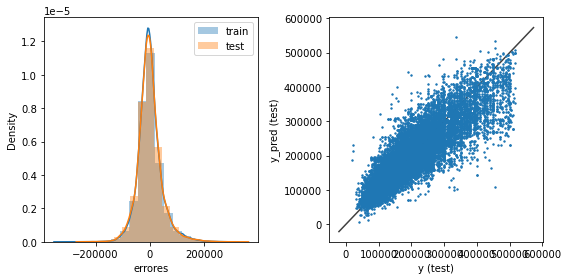

Pendientes: [ 3920.35814237  7331.12904917 16958.58845558 ...  -799.91861536
   813.9854308   -883.32790946]
Ordenada: 207594.05639504164
Raíz del error cuadrático medio en Train: 43731.12942853191
Raíz del error cuadrático medio en Test: 44302.96684887464


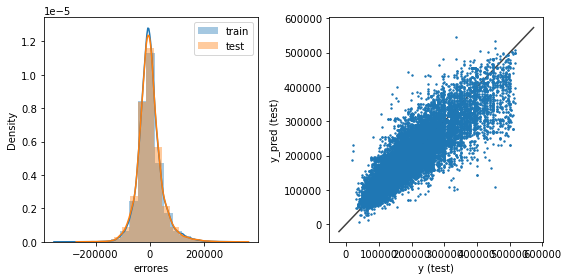

Pendientes: [ 3913.4247967   7336.17342783 16960.20287973 ...  -799.98077005
   814.00973444  -883.35936653]
Ordenada: 207604.4666808639
Raíz del error cuadrático medio en Train: 43731.120976583836
Raíz del error cuadrático medio en Test: 44303.556080004986


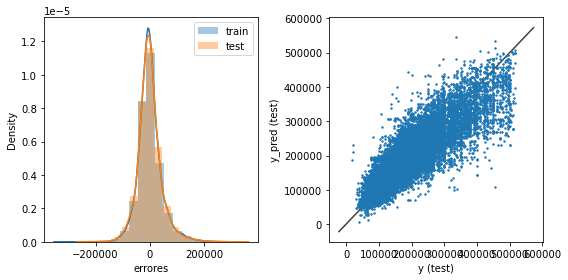

Pendientes: [ 3912.55589013  7336.8077962  16960.40478501 ...  -799.98851966
   814.01274516  -883.36321625]
Ordenada: 207605.77259814777
Raíz del error cuadrático medio en Train: 43731.1207102034
Raíz del error cuadrático medio en Test: 44303.63075029983


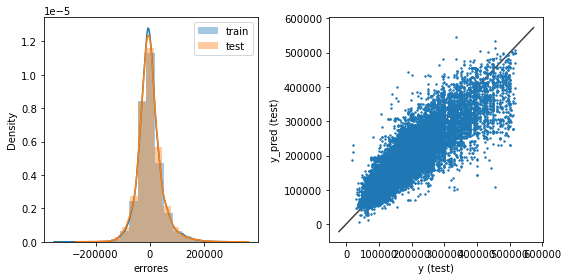

Pendientes: [ 3911.86040448  7337.31590594 16960.56632596 ...  -799.99480721
   814.01529965  -883.36604823]
Ordenada: 207606.81939181732
Raíz del error cuadrático medio en Train: 43731.12062484326
Raíz del error cuadrático medio en Test: 44303.69065078149


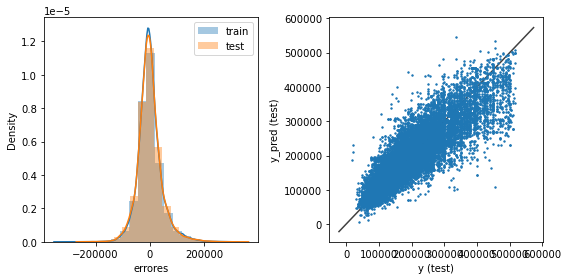

Pendientes: [ 3911.70387852  7337.43030374 16960.60267527 ...  -799.99779239
   814.01746795  -883.36372526]
Ordenada: 207607.0732692005
Raíz del error cuadrático medio en Train: 43731.120621319016
Raíz del error cuadrático medio en Test: 44303.704149239435


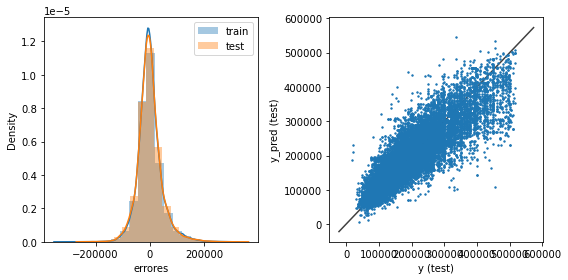

Pendientes: [ 3911.69518484  7337.43665751 16960.60469528 ...  -799.99950967
   814.01971795  -883.3601138 ]
Ordenada: 207607.1064218831
Raíz del error cuadrático medio en Train: 43731.12062129232
Raíz del error cuadrático medio en Test: 44303.70490013933


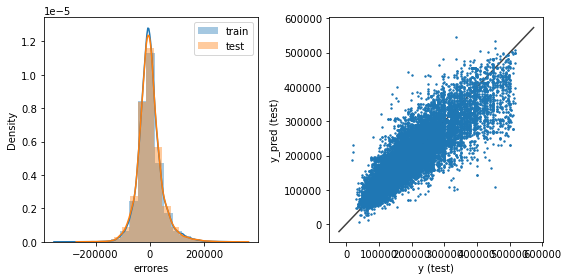

Pendientes: [ 3911.68825202  7337.44172019 16960.60631572 ...  -800.01681479
   814.03348592  -883.3311926 ]
Ordenada: 207607.2880101431
Raíz del error cuadrático medio en Train: 43731.12062128377
Raíz del error cuadrático medio en Test: 44303.70550639518


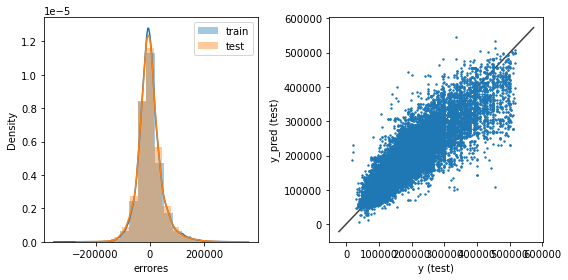

In [79]:
# Aplicamos un for para ver qué alpha es conveniente utilizar

for alpha in [10, 5, 1, 0.5, 0.1 ,0.01, 0.005, 0.001]:
#for alpha in [10, 1, 0.1 ,0.01, 0.001]:
#for alpha in [0.001]:

    reg_ridge = Ridge(alpha= alpha)
    reg_ridge.fit(X_train_new,y_train)
    
    #y_train_pred_ridge = reg_ridge.predict(X_train_new)
    #y_test_pred_ridge = reg_ridge.predict(X_test_new)
    
    print(f'Pendientes: {reg_ridge.coef_}')
    print(f'Ordenada: {reg_ridge.intercept_}')
    evaluar_regresion(reg_ridge, X_train_new, X_test_new, y_train, y_test)

Otra alternativa en vez de utilizar un for es aplicar la optimización de hiperparámetros mediante un Grid Search. 

Utilizando un "for" para algunos parámetros vemos que con un alpha de 10 es cuando se minimiza el RMSE. Aplicamos el Grid Search para optimizar en un rango menor.

In [80]:
modelo = Ridge()

grid = {'alpha':[15, 12, 10, 7.5, 5]}
#grid = {'alpha':[10]}

ridge_gs = GridSearchCV(estimator = modelo, param_grid=grid, cv=5, scoring= "neg_root_mean_squared_error")

ridge_gs.fit(X_train_new, y_train)

print("Mejor Hiperparámetro: ", ridge_gs.best_params_)
print("Mejor Resultado: ", ridge_gs.best_score_)
#print("Mínimo RMSE: ", nrmse(ridge_gs.best_score_))

Mejor Hiperparámetro:  {'alpha': 15}
Mejor Resultado:  -44288.16601671987


In [81]:
ridge_scores = pd.DataFrame(ridge_gs.cv_results_)
ridge_scores.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,5.339884,0.959311,0.046865,0.009892,15,{'alpha': 15},-44185.752018,-44426.644160,-43875.218975,-44372.551867,-44580.663064,-44288.166017,242.018833,1
1,4.901290,0.129604,0.044540,0.012010,12,{'alpha': 12},-44185.619102,-44427.083529,-43875.606481,-44372.666691,-44581.546999,-44288.504560,242.169985,2
2,4.675996,0.155501,0.054243,0.031175,10,{'alpha': 10},-44185.534037,-44427.383518,-43875.870934,-44372.749766,-44582.148940,-44288.737439,242.272908,3
3,4.729806,0.212445,0.039850,0.007179,7.5,{'alpha': 7.5},-44185.431788,-44427.766618,-43876.208489,-44372.861130,-44582.915874,-44289.036780,242.404044,4
4,4.722672,0.110114,0.043118,0.007144,5,{'alpha': 5},-44185.334179,-44428.158899,-43876.553924,-44372.981041,-44583.699220,-44289.345453,242.538004,5


#### Modelo 2: Random Forest Regressor

In [86]:
rfr = RandomForestRegressor(oob_score=True)
rfr.fit(X_train_esc, y_train.values.ravel())

RandomForestRegressor(oob_score=True)

In [87]:
y_train_pred_rfr = rfr.predict(X_train_esc)
y_test_pred_rfr = rfr.predict(X_test_esc)

print("R2 en oob_score: ", rfr.oob_score_)
print("R2 en Train: ", rfr.score(X_train_esc, y_train))
print("R2 en Test: ", rfr.score(X_test_esc, y_test))

R2 en oob_score:  0.8604535557826217
R2 en Train:  0.947857881845176
R2 en Test:  0.8569896319977088


In [88]:
# Calculo el error
rmse_train_rfr = np.sqrt(mean_squared_error(y_train, y_train_pred_rfr))
rmse_test_rfr = np.sqrt(mean_squared_error(y_test, y_test_pred_rfr))


print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_rfr))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_rfr}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_rfr}')

R Cuadrado Test: 0.8569896319977088

Raíz del error cuadrático medio en Train: 21350.8082819242
Raíz del error cuadrático medio en Test: 34955.89090764707


In [89]:
print(rfr.get_params())

{'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'mse', 'max_depth': None, 'max_features': 'auto', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_impurity_split': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': True, 'random_state': None, 'verbose': 0, 'warm_start': False}


In [97]:
# Optimización de hiperparámetros

modelo_rfr = RandomForestRegressor(oob_score=True, n_jobs= -1)

#modelo = RandomForestRegressor()
param_trees = {'n_estimators': [25, 50, 100, 150, 200], 
               'max_depth': sp.stats.randint(1, 20), 
               'min_samples_leaf':sp.stats.randint(1, 7)}

# Utilizo un Random Search por ser más eficiente que el Grid Search en el uso computacional
rfr_rs = RandomizedSearchCV(modelo_rfr, cv=5, param_distributions= param_trees)

rfr_rs.fit(X_train_esc, y_train)

print("Mejor Hiperparámetro: ", rfr_rs.best_params_)
print("Mejor Resultado: ", rfr_rs.best_score_)
print("Mejor Modelo: ", rfr_rs.best_estimator_)

Mejor Hiperparámetro:  {'max_depth': 18, 'min_samples_leaf': 1, 'n_estimators': 150}
Mejor Resultado:  0.8326571120155963
Mejor Modelo:  RandomForestRegressor(max_depth=18, n_estimators=150, n_jobs=-1, oob_score=True)


In [98]:
rfr_scores = pd.DataFrame(rfr_rs.cv_results_)
rfr_scores.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_min_samples_leaf,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,13.317989,1.188021,0.099954,0.007654,6,2,200,"{'max_depth': 6, 'min_samples_leaf': 2, 'n_est...",0.693630,0.689928,0.690425,0.687438,0.690634,0.690411,0.001974,6
1,1.891283,0.087034,0.074960,0.006234,1,5,100,"{'max_depth': 1, 'min_samples_leaf': 5, 'n_est...",0.399646,0.384373,0.379727,0.390131,0.380517,0.386879,0.007369,10
2,4.247762,0.010522,0.056745,0.007050,8,3,50,"{'max_depth': 8, 'min_samples_leaf': 3, 'n_est...",0.736190,0.735848,0.734620,0.730876,0.736453,0.734797,0.002059,4
3,24.658129,2.484663,0.177996,0.012735,18,1,150,"{'max_depth': 18, 'min_samples_leaf': 1, 'n_es...",0.837798,0.836197,0.832840,0.829183,0.827269,0.832657,0.004002,1
4,17.520306,1.799317,0.115561,0.007656,12,6,150,"{'max_depth': 12, 'min_samples_leaf': 6, 'n_es...",0.791670,0.788158,0.787202,0.783439,0.784233,0.786941,0.002950,3


In [99]:
# Vemos como realiza la predicción con Random Forest

y_train_pred_rfr_rs = rfr_rs.predict(X_train_esc)
y_test_pred_rfr_rs = rfr_rs.predict(X_test_esc)

# Calculo el error
rmse_train_rfr_rs = np.sqrt(mean_squared_error(y_train, y_train_pred_rfr_rs))
rmse_test_rfr_rs = np.sqrt(mean_squared_error(y_test, y_test_pred_rfr_rs))


print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_ridge_gs))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_rfr_rs}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_rfr_rs}')

R Cuadrado Test: 0.7702980301723921

Raíz del error cuadrático medio en Train: 30276.693709750245
Raíz del error cuadrático medio en Test: 37917.82567964337


#### Modelo 3: SVM Regression

In [100]:
svr = SVR()
svr.fit(X_train_esc, y_train)

SVR()

In [101]:
y_train_pred_svr = svr.predict(X_train_esc)
y_test_pred_svr = svr.predict(X_test_esc)

#print("R2 en oob_score: ", svr.oob_score_)
#print("R2 en Train: ", svr.score(X_train_esc, y_train))
#print("R2 en Test: ", svr.score(X_test_esc, y_test))

In [102]:
# Calculo el error
rmse_train_svr = np.sqrt(mean_squared_error(y_train, y_train_pred_svr))
rmse_test_svr = np.sqrt(mean_squared_error(y_test, y_test_pred_svr))


print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_svr))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_svr}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_svr}')

R Cuadrado Test: -0.04712020916883608

Raíz del error cuadrático medio en Train: 95730.93291263214
Raíz del error cuadrático medio en Test: 94587.74762471048


In [103]:
svr_rs = SVR(C=1, gamma=10, kernel='linear')
svr_rs.fit(X_train, y_train)
y_train_pred_svr_rs = svr_rs.predict(X_train_esc)
y_test_pred_svr_rs = svr_rs.predict(X_test_esc)
rmse_train_svr_rs = np.sqrt(mean_squared_error(y_train, y_train_pred_svr_rs))
rmse_test_svr_rs = np.sqrt(mean_squared_error(y_test, y_test_pred_svr_rs))


#print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_svr_rs))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_svr_rs}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_svr_rs}')


Raíz del error cuadrático medio en Train: 198052.38001088676
Raíz del error cuadrático medio en Test: 197204.86773314993


In [ ]:
parameters = {'kernel':('linear' , 'rbf'), 'C':[1, 10, 100, 1000], 'gamma':[0.001, 0.01, 0.1,1, 10,100]}

svr_gs = RandomizedSearchCV(svr, parameters, cv = 5, n_jobs = -1, return_train_score=True) ### completar
svr_gs.fit(X_train, y_train)

In [ ]:
#y_train_pred_svr_gs = svr_gs.predict(X_train_esc)
y_test_pred_svr_gs = svr_gs.predict(X_test_esc)

In [ ]:
svr_gs.best_estimator_

In [ ]:
# Calculo el error
rmse_train_svr_gs = np.sqrt(mean_squared_error(y_train, y_train_pred_svr_gs))
rmse_test_svr_gs = np.sqrt(mean_squared_error(y_test, y_test_pred_svr_gs))


print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_svr_gs))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_svr_gs}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_svr_gs}')

#### Modelo 4: XGBoost Regressor

In [104]:
xgbr = XGBRegressor()
xgbr.fit(X_train_esc, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [105]:
y_train_pred_xgbr = xgbr.predict(X_train_esc)
y_test_pred_xgbr = xgbr.predict(X_test_esc)

#print("R2 en oob_score: ", xgbr.oob_score_)
print("R2 en Train: ", xgbr.score(X_train_esc, y_train))
print("R2 en Test: ", xgbr.score(X_test_esc, y_test))

R2 en Train:  0.8520428472393
R2 en Test:  0.8230651620399433


In [106]:
# Calculo el error
rmse_train_xgbr = np.sqrt(mean_squared_error(y_train, y_train_pred_xgbr))
rmse_test_xgbr = np.sqrt(mean_squared_error(y_test, y_test_pred_xgbr))


print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_xgbr))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_xgbr}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_xgbr}')

R Cuadrado Test: 0.8230651620399433

Raíz del error cuadrático medio en Train: 35965.65456850658
Raíz del error cuadrático medio en Test: 38881.524926238664


In [107]:
import scipy.stats as st

params = {  
    "n_estimators": st.randint(20,40), # Number of boosted trees to fit.
    "max_depth": st.randint(3, 12),     # Maximum tree depth for base learners.
    "learning_rate": st.uniform(0.05, 0.4), #     Boosting learning rate (xgb’s “eta”)
    #"colsample_bytree": one_to_left, #     Subsample ratio of columns when constructing each tree.
    #"subsample": one_to_left,     # Subsample ratio of the training instance.
    "gamma": st.uniform(0, 10), #     Minimum loss reduction required to make a further partition on a leaf node of the tree.
    'reg_alpha': st.uniform(0.05,10),   # L1 regularization term on weights
    "min_child_weight": st.uniform(1,20), #    Minimum sum of instance weight(hessian) needed in a child.
}

# Utilizo un Random Search por ser más eficiente que el Grid Search en el uso computacional

xgbr_rs = RandomizedSearchCV(xgbr,params, n_iter=25, verbose= True)

xgbr_rs.fit(X_train_esc, y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


RandomizedSearchCV(estimator=XGBRegressor(base_score=0.5, booster='gbtree',
                                          colsample_bylevel=1,
                                          colsample_bynode=1,
                                          colsample_bytree=1, gamma=0,
                                          gpu_id=-1, importance_type='gain',
                                          interaction_constraints='',
                                          learning_rate=0.300000012,
                                          max_delta_step=0, max_depth=6,
                                          min_child_weight=1, missing=nan,
                                          monotone_constraints='()',
                                          n_estimators=100, n_jobs=4,
                                          num_parallel...
                                        'max_depth': <scipy.stats._distn_infrastructure.rv_frozen object at 0x000002C2003DB100>,
                                      

In [108]:
xgbr_rs.best_estimator_

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=7.125338001600827,
             gpu_id=-1, importance_type='gain', interaction_constraints='',
             learning_rate=0.4323153419396907, max_delta_step=0, max_depth=9,
             min_child_weight=14.30904703428507, missing=nan,
             monotone_constraints='()', n_estimators=31, n_jobs=4,
             num_parallel_tree=1, random_state=0, reg_alpha=4.523371783852357,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [109]:
y_train_pred_xgbr_rs = xgbr_rs.predict(X_train_esc)
y_test_pred_xgbr_rs = xgbr_rs.predict(X_test_esc)

In [110]:
# Calculo el error
rmse_train_xgbr_rs = np.sqrt(mean_squared_error(y_train, y_train_pred_xgbr_rs))
rmse_test_xgbr_rs = np.sqrt(mean_squared_error(y_test, y_test_pred_xgbr_rs))


print(f'R Cuadrado Test:', r2_score(y_test, y_test_pred_xgbr_rs))

print()
print(f'Raíz del error cuadrático medio en Train: {rmse_train_xgbr_rs}')
print(f'Raíz del error cuadrático medio en Test: {rmse_test_xgbr_rs}')

R Cuadrado Test: 0.823467538527038

Raíz del error cuadrático medio en Train: 36205.40383718911
Raíz del error cuadrático medio en Test: 38837.288538142166


### Comparo los modelos


In [112]:
# Conclusiones
#print("Los resultados finales fueron:\n - RMSE de Ridge:", rmse_test_ridge_gr," \n - RMSE de Random Forest:", rmse_test_rfr_rs, " \n - RMSE de XGBoost:", rmse_test_xgbr_rs,
#     "\n - RMSE de SVR", rmse_test_svr_gs)

print("Los resultados finales fueron:\n - RMSE de Ridge:", rmse_test_ridge_gr," \n - RMSE de Random Forest:", rmse_test_rfr_rs, " \n - RMSE de XGBoost:", rmse_test_xgbr_rs,
     "\n - RMSE de SVR", rmse_test_svr_rs)

Los resultados finales fueron:
 - RMSE de Ridge: 44301.55526498206  
 - RMSE de Random Forest: 37917.82567964337  
 - RMSE de XGBoost: 38837.288538142166 
 - RMSE de SVR 197204.86773314993


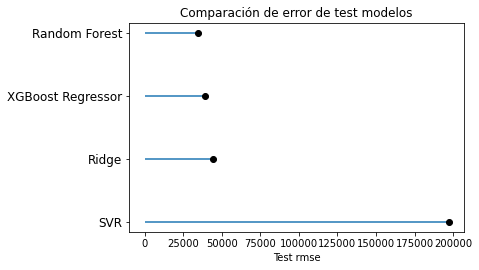

In [114]:
error_modelos = pd.DataFrame({
                        'modelo': ['Ridge', 'Random Forest', 'XGBoost Regressor', 'SVR'],
                        'rmse': [rmse_test_ridge_gr, rmse_test_rfr  , rmse_test_xgbr, rmse_test_svr_rs]
                     })
error_modelos = error_modelos.sort_values('rmse', ascending=False)

fig, ax = plt.subplots(figsize=(6, 3.84))
ax.hlines(error_modelos.modelo, xmin=0, xmax=error_modelos.rmse)
ax.plot(error_modelos.rmse, error_modelos.modelo, "o", color='black')
ax.tick_params(axis='y', which='major', labelsize=12)
ax.set_title('Comparación de error de test modelos'),
ax.set_xlabel('Test rmse');

Raíz del error cuadrático medio en Train: 30276.693709750245
Raíz del error cuadrático medio en Test: 37917.82567964337


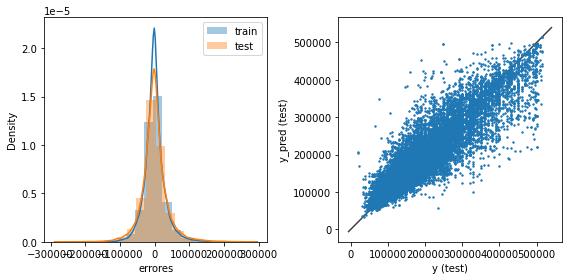

Raíz del error cuadrático medio en Train: 36205.40383718911
Raíz del error cuadrático medio en Test: 38837.288538142166


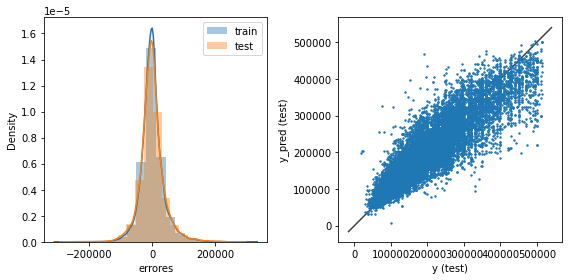

Raíz del error cuadrático medio en Train: 43731.1982368332
Raíz del error cuadrático medio en Test: 44301.55526498206


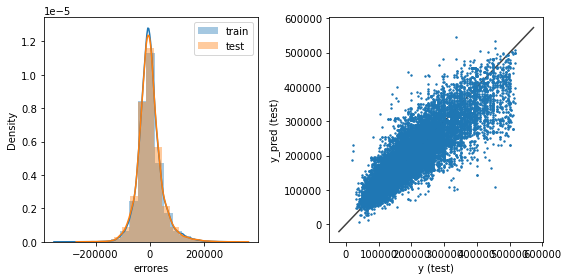

Raíz del error cuadrático medio en Train: 198052.38001088676
Raíz del error cuadrático medio en Test: 197204.86773314993


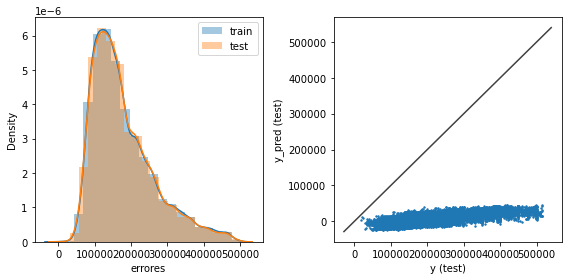

In [143]:
for model in [rfr_rs, xgbr_rs, ridge_gs, svr_rs]:
    if model == ridge_gs:
        evaluar_regresion(model,X_train_new,X_test_new,y_train,y_test)
     
    else:
        evaluar_regresion(model,X_train_esc,X_test_esc,y_train,y_test)

En función al desempeño de los modelos y las métricas utilizadas, el modelo que elijo es el Random Forest con los hiperparámetros seleccionados. 

### 3. Interpretación de Modelos

De acuerdo a lo que el modelo permite, responde alguna de las siguientes preguntas:

¿Qué variables fueron relevantes para el modelo para hacer una predicción? ¿Cuáles no? Si usaste una regularización lineal con regularización presta atención a los parámetros (pendientes) obtenidos. Si usaste un modelo de ensamble en árboles, además de ver la importancia de cada atributo, también elige árboles al azar y observa qué atributos considera importantes.
¿En qué se diferencian esos árboles? ¿Por qué? Finalmente, responde ¿coincide con lo que esperabas a partir de tu experiencia con este dataset?

¿Cómo es la distribución de los errores? ¿Dónde fallan los modelos? ¿A qué crees que se debe?

Text(0, 0.5, 'Atributos')

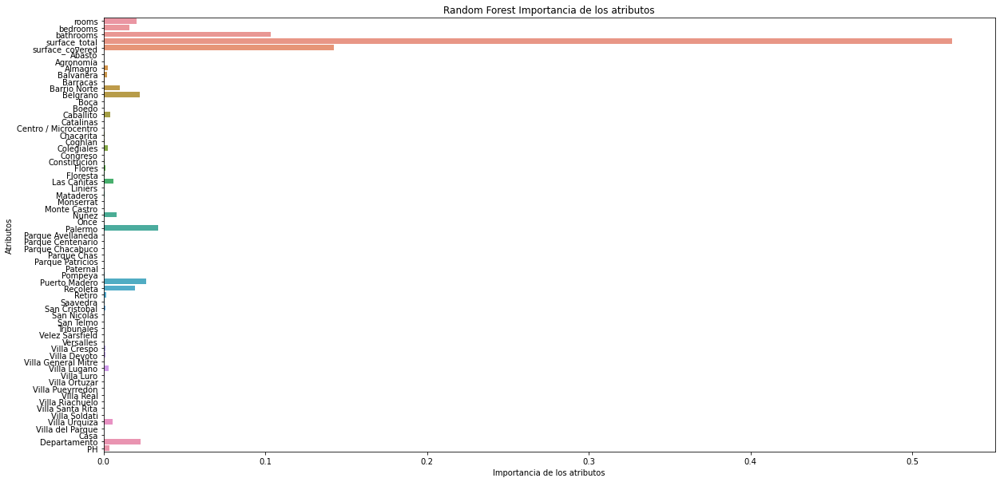

In [158]:
#Define size of bar plot
plt.figure(figsize=(20,10))
#Plot Searborn bar chart
sns.barplot(x=rfr_rs.best_estimator_.feature_importances_, y=X.columns)
#Add chart labels
plt.title("Random Forest " + 'Importancia de los atributos')
plt.xlabel('Importancia de los atributos')
plt.ylabel('Atributos')

In [159]:
rfr_rs.best_estimator_.feature_importances_

array([2.04704282e-02, 1.57859285e-02, 1.03202676e-01, 5.24869252e-01,
       1.42216602e-01, 8.98095411e-05, 6.02733190e-05, 2.61398520e-03,
       2.42169494e-03, 8.86156639e-04, 1.03169715e-02, 2.25299200e-02,
       3.61399912e-04, 2.98848113e-04, 4.03065549e-03, 4.73412544e-07,
       1.12958944e-04, 5.44992225e-04, 8.95663830e-04, 2.62162062e-03,
       2.60112433e-04, 6.55133477e-04, 1.11232515e-03, 6.18653883e-04,
       6.13411324e-03, 2.96520430e-04, 6.41263331e-04, 3.10137783e-04,
       1.82511946e-04, 8.19506751e-03, 2.86241263e-04, 3.37589268e-02,
       2.04041040e-04, 3.20132876e-04, 4.53278019e-04, 1.71449671e-04,
       2.08264978e-04, 2.17857774e-04, 6.21753480e-04, 2.64947180e-02,
       1.92414608e-02, 1.89027374e-03, 7.97776397e-04, 1.32542750e-03,
       2.66714061e-04, 1.71496306e-04, 1.97240788e-04, 2.19114246e-05,
       3.49221297e-05, 1.31212440e-03, 1.16566976e-03, 1.84019718e-04,
       3.12587416e-03, 7.89585172e-04, 2.26100878e-04, 2.87856834e-04,
      

Las variables más relevantes para el modelo con mejor desempeño, el Random Forest, fueron:

    1- surface_total
    2- surface_covered
    3- bathrooms
    
En cuanto a mi experiencia sobre el modelo, esperaba que la superficie fuese un buen atributo para el modelo ya que considero que es una variable muy considerada la hora de formar precio, no así con baños que fue un atributo que pensé que tendría un peso menor.
También, en un primer momento, consideré que el tipo de propiedad o ubicación tendrían una ponderación mayor.




Un análisis sobre los errores de los modelos nos entregan la siguiente conclusión dependiendo de cada uno de ellos y de lo observado en el punto donde se comparan con gráficos los resultados de los modelos:

Modelo Random Forest      
Este fue el modelo con mejor desempeño para el caso analizado y arrojó: 

RMSE en Train: 30276.69 

RMSE en Test: 37917.82
    
Vemos que la diferencia entre ambos RMSE refleja que existe un sesgo bajo pero que sufre de un cierto grado de varianza. Esto es más usual en aquellos modelos más complejos y en general, a medida que aumenta la complejidad aumenta la varianza.
Para reducir la varianza se podría disminuir la complejidad del modelo, agregar más datos al modelo, ya sean reales o sintéticos.
En función a los gráficos se puede observar que los valores de y(test) se ajustan de mejor manera al resto de los modelos. También se observa en el gráfico de errores que la varianza no difiere significativamente entre los modelos ya que el ancho de la campana del gráfico es similar. 

Modelo Ridge    
El modelo entrenado es el que mayor error arroja. Se puede observar que los valores del y(test) se alejan de la recta de y(train) por lo que las predicciones varían de los valores reales.
  
Si bien el modelo parece tener menor varianza estamos ante un caso donde hay alta varianza y alto sesgo. El error del sesgo en general es consecuencia del modelo aplicado, es decir que Ridge no es un modelo a utilizar para esta problemática.
  
Se analizan estos dos modelos por ser los más representativos de los errores.


### 4. Cierre

Escribe las conclusiones a las que hayas llegado en este trabajo:

Este nuevo proyecto sobre el dataset ya utilizado fue muy útil para ver el avance con la aplicación de una transformación de los datos más completa con respecto a la anterior. Además la posibilidad de comparar entre distintos modelos, ajustando parámetros, me sirvió para elegir el modelo a utilizar en función de varias opciones y no a través de un trabajo más manual. El desempeño del nuevo modelo me sorprendió porque mejoró bastante con respecto al del proyecto uno y no esperaba lograr tal mejora.
Una de las cuestiones que no hubiera realizado, sería el escalado de datos para la comparación del punto 1 ya que para el caso en particular donde se utiliza un Árbol de Decisión, el desempeño del modelo prácticamente no varía.


### Requerimientos adicionales

**Implementa una transformación de datos distinta a las que probaste anteriormente. Puedes investigar si existe alguna apropiada para este tipo de problemas.**

In [22]:
# Se filtra el dataset para que sea comparable con el Sprint Project 1
propiedades_clust = dataset_sin_dup[dataset_sin_dup.property_type.isin(["Departamento", "Casa", "PH"]) &
                               dataset_sin_dup.l2.isin(["Capital Federal"])]

#print('Cantidad orignal de filas',propiedades_sp2_df.shape[0],'con',propiedades_sp2_df.shape[1],'columnas')

propiedades_clust = propiedades_clust.drop(axis=0, index = propiedades_clust.loc[propiedades_clust.surface_total<15].index)
propiedades_clust = propiedades_clust.drop(axis=0, index = propiedades_clust.loc[propiedades_clust.surface_total>1000].index)
propiedades_clust = propiedades_clust.drop(axis=0, index = propiedades_clust.loc[propiedades_clust.price>4000000].index)

In [23]:
propiedades_clust = propiedades_clust[["l3", "rooms", "bedrooms", "bathrooms", "surface_total", "surface_covered", "price", "property_type", "lat", "lon"]]
propiedades_clust.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,lat,lon
0,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Departamento,-34.605880,-58.384949
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,-34.624056,-58.412110
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,-34.593569,-58.427474
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,-34.581294,-58.436754
5,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,-34.593779,-58.441239


Eliminación de outliers


In [24]:
# Hay casos donde la superficie cubierta es mayor que la superficie total, se presupone que corresponden a instancias que se completaron de manera incorrecta, 
#imputando los datos de forma cruzada

propiedades_clust_sup = propiedades_clust.loc[propiedades_clust.surface_total < propiedades_clust.surface_covered]
print(len(propiedades_clust_sup))

751


In [25]:
propiedades_clust.loc[propiedades_clust_sup.index,'surface_total'] = propiedades_clust_sup.surface_covered
propiedades_clust.loc[propiedades_clust_sup.index,'surface_covered'] = propiedades_clust_sup.surface_total
### Para verificar que las invirtio 
propiedades_clust_sup = propiedades_clust.loc[propiedades_clust.surface_total < propiedades_clust.surface_covered]
print(len(propiedades_clust_sup))
propiedades_clust.reset_index(drop=True,inplace=True)

0


In [26]:
propiedades_clust.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,lat,lon
0,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Departamento,-34.605880,-58.384949
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,-34.624056,-58.412110
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,-34.593569,-58.427474
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,-34.581294,-58.436754
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,-34.593779,-58.441239


In [27]:
propiedades_clust.shape

(89683, 10)

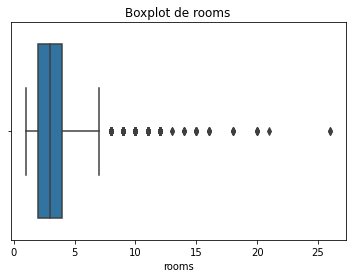

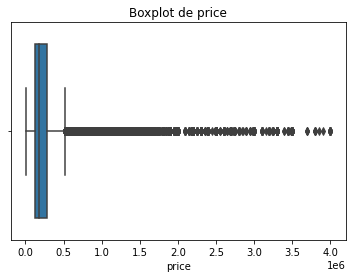

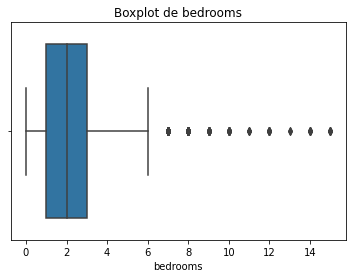

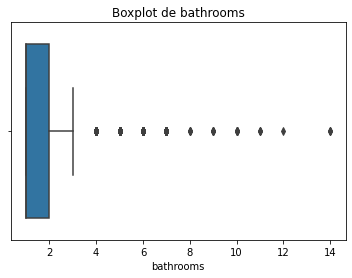

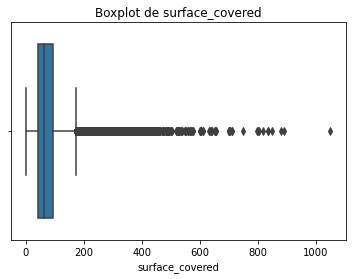

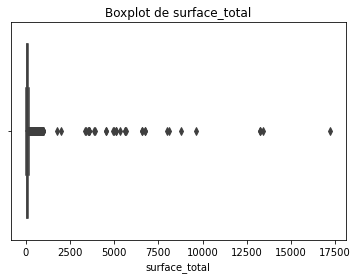

In [13]:
# Se analiza mediante bloxplots los outliers de los atributos numéricos

for atributo in ["rooms", "price", "bedrooms", "bathrooms", "surface_covered", "surface_total"]:
    sns.boxplot(propiedades_clust[atributo])
    plt.title(f"Boxplot de {atributo}")
    plt.show()

In [28]:
#Eliminación de outliers del dataset completo

q1 = propiedades_clust.quantile(0.25)
q3 = propiedades_clust.quantile(0.75)
iqr = q3 - q1
propiedades_clust=propiedades_clust[~((propiedades_clust < (q1 - 1.5 * iqr)) |(propiedades_clust > (q3 + 1.5 * iqr))).any(axis=1)]

In [29]:
# Vemos el tamaño del dataset luego de eliminar outliers y realizamos un nuevo describe para ver cómo se modificaron los estadísticos del dataset modificado
propiedades_clust.shape


(77835, 10)

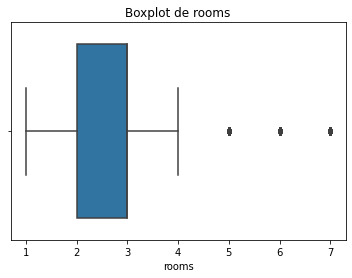

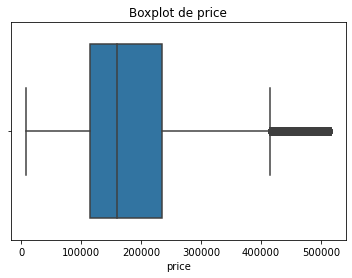

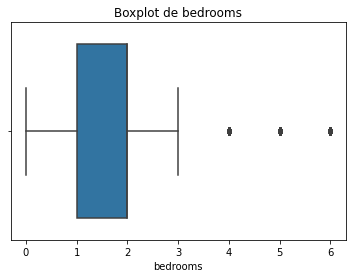

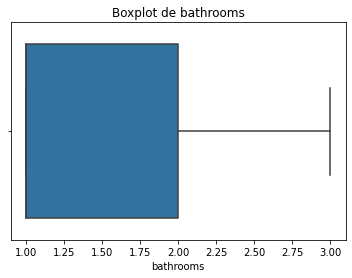

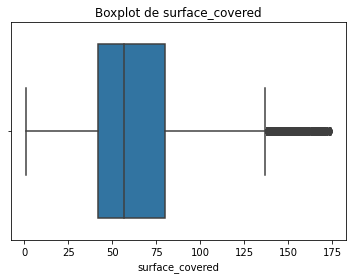

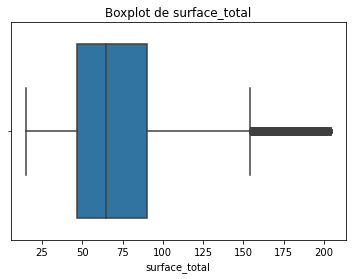

In [30]:
# Volvemos a realizar bloxplots luego de eliminados los outliers 

for atributo in ["rooms", "price", "bedrooms", "bathrooms", "surface_covered", "surface_total"]:
    sns.boxplot(propiedades_clust[atributo])
    plt.title(f"Boxplot de {atributo}")
    plt.show()

Imputación de valores faltantes

In [31]:
propiedades_clust.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,lat,lon
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,-34.624056,-58.412110
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,-34.593569,-58.427474
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,-34.581294,-58.436754
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,-34.593779,-58.441239
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH,-34.600988,-58.433061


In [32]:
# Valores faltantes
datos_faltantes= pd.DataFrame(propiedades_clust.isna().sum(), columns = ["valores_faltantes"])
datos_faltantes[datos_faltantes.valores_faltantes>0]

,valores_faltantes
bathrooms,1980
surface_total,8043
surface_covered,8299
lat,3359
lon,3370


In [33]:
# Utilizo KNN Imputer para completar los valores faltantes
from sklearn.impute import KNNImputer

In [34]:
KNN_imputer=KNNImputer(n_neighbors=6)
KNN_imputer=KNN_imputer.fit(propiedades_clust.iloc[:,3:6])
propiedades_clust.iloc[:,3:6]=KNN_imputer.transform(propiedades_clust.iloc[:,3:6])

In [35]:
KNN_imputer=KNNImputer(n_neighbors=6)
KNN_imputer=KNN_imputer.fit(propiedades_clust.iloc[:,8:10])
propiedades_clust.iloc[:,8:10]=KNN_imputer.transform(propiedades_clust.iloc[:,8:10])

In [36]:
propiedades_clust.isnull().sum()

l3                 0
rooms              0
bedrooms           0
bathrooms          0
surface_total      0
surface_covered    0
price              0
property_type      0
lat                0
lon                0
dtype: int64

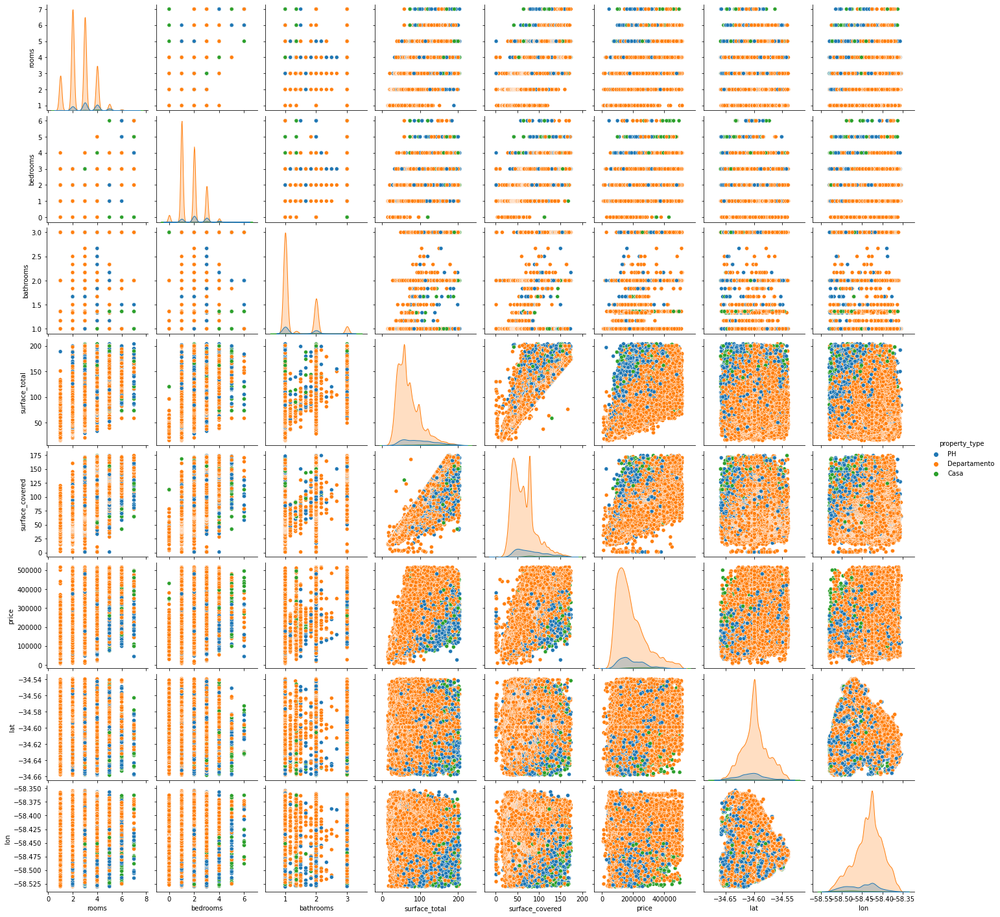

In [75]:
# Graficamos nuevamente un pairplot para ver si hubo modificaciones en la distribución de las variables

sns.pairplot(propiedades_clust, hue = 'property_type')
plt.show()

Además de aplicar un método distinto de imputación de valores faltantes, KNN Imputer, vamos a implementar PCA/SVD.

In [37]:
from sklearn.preprocessing import StandardScaler

X_pca = propiedades_clust.drop(["price", "l3", "property_type"], axis=1) # Separating out the target
y_pca = propiedades_clust["price"].values# Standardizing the features
X_pca = StandardScaler().fit_transform(X_pca)

In [38]:
X_train_pca,X_test_pca,y_train_pca,y_test_pca= train_test_split(X_pca,y_pca,test_size=0.3,random_state=42)

In [118]:
pca=PCA

for i in range(2,8):
    pca =PCA(n_components=i,random_state=42)
    X_train=pca.fit_transform(X_train_pca)
    X_test=pca.transform(X_test_pca)


    tree = DecisionTreeRegressor(max_depth=10,random_state=42)
    tree.fit(X_train,y_train_pca)
    
    y_pred = tree.predict(X_test)

    RMSE=np.sqrt(mean_squared_error(y_test_pca,y_pred))
    print("Componentes:",i)
    print("RMSE para PCA:",RMSE)

Componentes: 2
RMSE para PCA: 55905.76829789398
Componentes: 3
RMSE para PCA: 45939.77138382128
Componentes: 4
RMSE para PCA: 44457.72930808146
Componentes: 5
RMSE para PCA: 43428.71786648253
Componentes: 6
RMSE para PCA: 43544.42290822818
Componentes: 7
RMSE para PCA: 43728.05633520875


In [128]:
svd=TruncatedSVD

for i in range(2,7):
    svd=TruncatedSVD(n_components=i,random_state=42)
    X_train_=svd.fit_transform(X_train_pca)
    X_test_=svd.transform(X_test_pca)
    
    tree = DecisionTreeRegressor(max_depth=10,random_state=42)
    tree.fit(X_train_,y_train_pca)
    
    y_pred = tree.predict(X_test_)

    RMSE=np.sqrt(mean_squared_error(y_test_pca,y_pred))
    print("Componentes:",i)
    print("RMSE para SVD:",RMSE)

Componentes: 2
RMSE para SVD: 55875.6540722214
Componentes: 3
RMSE para SVD: 45932.07981757477
Componentes: 4
RMSE para SVD: 44456.30882935517
Componentes: 5
RMSE para SVD: 43430.066411618
Componentes: 6
RMSE para SVD: 43614.939616557065


Vemos que el PCA con 5 componentes es el que mejor desempeño tiene con respecto a otros componentes del mismo PCA y con respecto SVD.

In [131]:
modelo_rfr_pca = RandomForestRegressor(random_state=42,bootstrap=False, criterion= "mse", max_depth= 18, max_features= "sqrt", n_estimators= 150, min_samples_leaf=1)
modelo_rfr_pca.fit(X_train_,y_train_pca)

RandomForestRegressor(bootstrap=False, max_depth=18, max_features='sqrt',
                      n_estimators=150, random_state=42)

In [132]:
y_train_pca_rf = modelo_rfr_pca.predict(X_train_)
y_test_pca_rf = modelo_rfr_pca.predict(X_test_)

rmse_train_pca_rf = np.sqrt(mean_squared_error(y_train_pca, y_train_pca_rf))
rmse_test_pca_rf = np.sqrt(mean_squared_error(y_test_pca, y_test_pca_rf))

print("RMSE en Train es:",rmse_train_pca_rf)
print("RMSE en Test es:",rmse_test_pca_rf)

RMSE en Train es: 12785.280433548802
RMSE en Test es: 31003.62075315256


Podemos ver que con algunos ajustes en la transformación de datos el desempeño del modelo mejora con respecto al proyecto 1 y con respecto a este mismo proyecto en su primera sección. Para este análisis se utilizó el modelo de Random Forest con los mismos hiperparámetros que habíamos obtenido en el punto dos.
En este caso hay una mayor diferencia entre el resultado en train y en test, esto puede significar un sobreajuste de los datos.

**Aplica una técnica de Clustering sobre el dataset. Puedes combinar con técnicas de reducción de dimnesionalidad para facilitar la visualización. ¿Qué cluster encuentras? ¿A qué pueden corresponder?
Te dejamos preguntas que pueden servir como disparadores: ¿qué barrios se parecen más entre sí? ¿Qué tipos de propiedades se parecen más entre sí?**


In [39]:
# copiamos el dataset
prop_clusters = propiedades_clust.copy()
prop_clusters.head()

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,lat,lon
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,-34.624056,-58.412110
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,-34.593569,-58.427474
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,-34.581294,-58.436754
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,-34.593779,-58.441239
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH,-34.600988,-58.433061


In [40]:
#filtramos por lat y lon
prop_clust = prop_clusters[["lat","lon"]]
prop_clust.head()

,lat,lon
1,-34.624056,-58.412110
2,-34.593569,-58.427474
3,-34.581294,-58.436754
4,-34.593779,-58.441239
5,-34.600988,-58.433061


In [41]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

In [42]:
X_clust = prop_clust[['lon']]
y_clust = prop_clust[['lat']]

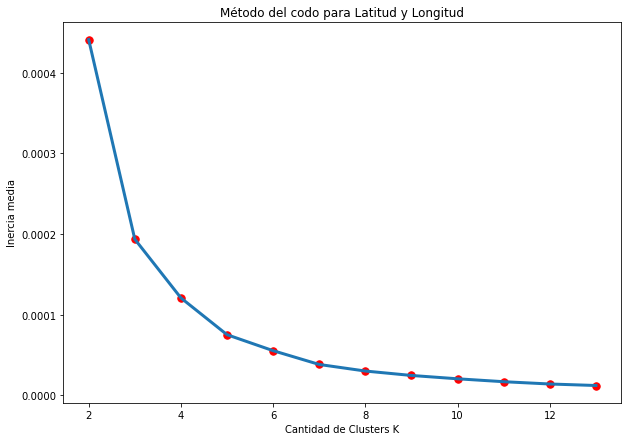

In [43]:
# Vemos donde realiza el punto de quiebre con el método del codo

K = np.arange(2,14)

# Preparamos una lista donde vamos a ir agregando las distancias medias
Sum_of_squared_distances = []
# Fiteammos un modelo para cada numero de cluster que queremos testear
for k in K:
    # Definimos y entrenamos el modelo
    km = KMeans(n_clusters=k)
    km = km.fit(X_clust)
    # Calculamos la distancia media y agregamos a la lista
    distancia_total = km.inertia_
    distancia_media = np.divide(distancia_total,X_clust.shape[0])
    Sum_of_squared_distances.append(distancia_media)
    
plt.figure(figsize = (10,7))
plt.plot(K, Sum_of_squared_distances, lw=3)
plt.scatter(K, Sum_of_squared_distances,s=55,c='r')
plt.xlabel('Cantidad de Clusters K')
plt.ylabel('Inercia media')
plt.title('Método del codo para Latitud y Longitud')

plt.show()

En k=3 se ve el punto de inflexion, hasta ese punto crece despacio y en 3 se dispara.

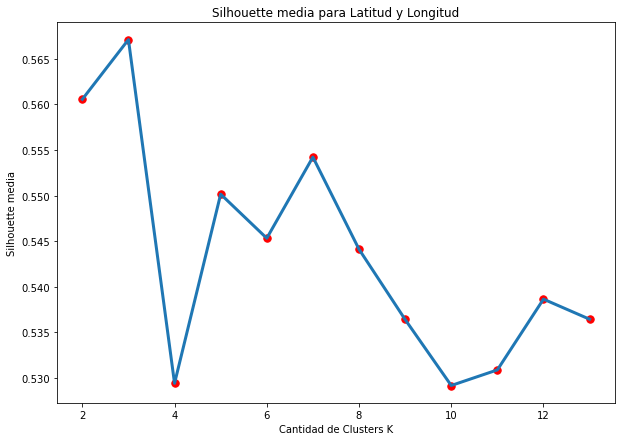

In [44]:
# Pruebo el Silhouette

# Preparamos una lista donde vamos a ir agregando los valores medios de silhouette
lista_sil = []
# Fiteammos un modelo para cada numero de cluster que queremos testear
for k in range(2,14):
    # Definimos y entrenamos el modelo
    km = KMeans(n_clusters=k)
    km = km.fit(X_clust)
    
    # Tomamos las etiquetas
    etiquetas = km.labels_
    
    # Calculamos el silhouette 
    valor_medio_sil = silhouette_score(X_clust, etiquetas)
    lista_sil.append(valor_medio_sil)
    
plt.figure(figsize = (10,7))
plt.plot(K, lista_sil, lw=3)
plt.scatter(K, lista_sil,s=55,c='r')
plt.xlabel('Cantidad de Clusters K')
plt.ylabel('Silhouette media')
plt.title('Silhouette media para Latitud y Longitud')

plt.show()

In [45]:
kmeans = KMeans(n_clusters = 12, init ='k-means++')
kmeans.fit(prop_clusters[prop_clusters.columns[8:10]]) # Compute k-means clustering.
prop_clust['cluster_label'] = kmeans.fit_predict(prop_clusters[prop_clusters.columns[8:10]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(prop_clusters[prop_clusters.columns[8:10]]) # Labels of each point
prop_clusters.head(10)

,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type,lat,lon
1,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH,-34.624056,-58.412110
2,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH,-34.593569,-58.427474
3,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH,-34.581294,-58.436754
4,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,PH,-34.593779,-58.441239
5,Villa Crespo,2.0,1.0,1.0,70.0,70.0,159500.0,PH,-34.600988,-58.433061
6,Parque Patricios,1.0,1.0,1.0,45.0,37.0,89000.0,PH,-34.639598,-58.419612
7,Villa Pueyrredón,2.0,1.0,2.0,66.0,49.0,170000.0,PH,-34.586225,-58.496220
8,Boedo,2.0,1.0,1.0,68.0,59.0,149000.0,Departamento,-34.603683,-58.381557
9,Boedo,2.0,1.0,1.0,50.0,44.0,115000.0,Departamento,-34.630349,-58.417223
10,Abasto,2.0,1.0,1.0,31.0,31.0,75000.0,Departamento,-34.608246,-58.444262


In [46]:
etiquetas_clust = kmeans.labels_ # miramos las etiquetas que les puso
centros_clust = kmeans.cluster_centers_ # centroides
print(centros_clust)
print(etiquetas_clust)


[[-34.59403981 -58.41566949]
 [-34.62560914 -58.43731572]
 [-34.57242292 -58.48428742]
 [-34.60410928 -58.50266261]
 [-34.62380225 -58.3748848 ]
 [-34.61695293 -58.40684487]
 [-34.57563452 -58.439752  ]
 [-34.60068153 -58.43792125]
 [-34.64036921 -58.50775696]
 [-34.62032558 -58.4683114 ]
 [-34.59750767 -58.39035187]
 [-34.55689418 -58.4618319 ]]
[5 0 6 ... 7 0 0]


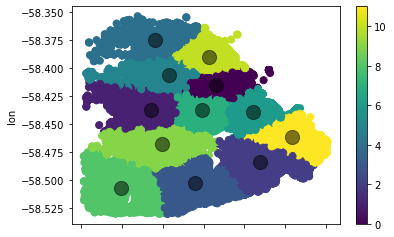

In [47]:
# Graficamos como quedan los clusters del dataset
prop_clust.plot.scatter(x = 'lat', y = 'lon', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5)

# Extra: 
Si bien no forma parte de la consigna, quise explorar los datos de una manera más visual identificando los inmuebles en un mapa por lo que use dos librerías distintas para graficar:

In [48]:
pip install plotly==5.3.1

In [64]:
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objs as go
pyo.init_notebook_mode(connected=True)

In [65]:
fig = px.scatter_mapbox(propiedades_clust, lat="lat", lon="lon", color="property_type",hover_data=['price'],hover_name="property_type",
                        animation_frame="l3",zoom=10,
                        title="Mapa de Capital Federal para Departamentos,PH y Casa",
                       )
fig.update_layout(mapbox_style="open-street-map")
pyo.offline.plot(fig, filename = "Mapa de Capital Federal para Departamentos,PH y Casa.html")
fig.show()

In [66]:
px.set_mapbox_access_token("pk.eyJ1IjoiZmVkZXNmcmVnb2xhIiwiYSI6ImNrdHV0NHV1YjIzZHUycG8zZ2pudnNydHoifQ.oN3KYC4zUAHr3_nged4KkQ")
fig = px.scatter_mapbox(propiedades_clust, lat="lat", lon="lon",color ="price", hover_name="property_type", size="price", hover_data=["price", "l3"],color_continuous_scale=px.colors.cyclical.IceFire, zoom=10, height=1000, center={"lat":-34.60652, "lon":-58.43557})
pyo.offline.plot(fig, filename = "Mapa de Capital Federal para Departamentos,PH y Casa.html")
fig.show()